In [3]:
import pandas as pd
import math
import numpy as np
import matplotlib.pyplot as plt
import wordcloud
from wordcloud import WordCloud
import seaborn as sns
import folium
import plotly.express as px

In [4]:
df = pd.read_csv('airbnb_cleaned_data.csv')

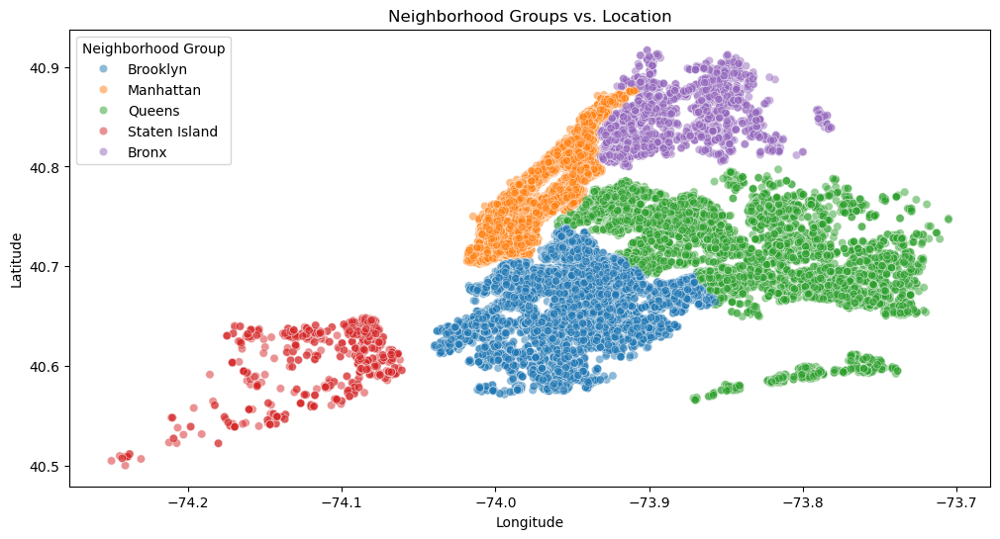

In [5]:
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df, x='long', y='lat', hue='neighbourhood group', alpha=0.5)
plt.title('Neighborhood Groups vs. Location')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.legend(title='Neighborhood Group')
plt.show()

In [7]:
# Create a list of neighborhood groups
neighborhood_groups = ['brooklyn', 'manhattan', 'queens', 'staten island', 'bronx']

# Loop through each neighborhood group and create a map
for neighborhood in neighborhood_groups:
    # Filter data for the current neighborhood group
    group_data = df[df['neighbourhood group'].str.lower().eq(neighborhood)].copy()

    # Get unique cancellation policies for the current group
    policies = group_data['cancellation_policy'].unique()
    print(f"Cancellation Policies in {neighborhood.capitalize()}: {policies}")

    # Create interactive map
    fig = px.scatter_mapbox(group_data,
                            lat="lat",
                            lon="long",
                            color="cancellation_policy",
                            hover_name="NAME",
                            hover_data=["price", "room type"],
                            zoom=11,
                            height=600,
                            title=f"Airbnb Cancellation Policies in {neighborhood.capitalize()}")

    # Set map style
    fig.update_layout(mapbox_style="open-street-map")
    fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
    fig.show()


Cancellation Policies in Brooklyn: ['strict' 'moderate' 'flexible']


Cancellation Policies in Manhattan: ['moderate' 'flexible' 'strict']


Cancellation Policies in Queens: ['flexible' 'strict' 'moderate']


Cancellation Policies in Staten island: ['strict' 'flexible' 'moderate']


Cancellation Policies in Bronx: ['flexible' 'moderate' 'strict']


In [9]:
# Create a list of neighborhood groups
neighborhood_groups = ['brooklyn','manhattan', 'queens', 'staten island', 'bronx']

# Loop through each neighborhood group and create a map
for neighborhood in neighborhood_groups:
    # Filter data for the current neighborhood group
    group_data = df[df['neighbourhood group'].str.lower().eq(neighborhood)].copy()

    # Get unique values of 'instant_bookable' for the current group
    bookable_status = group_data['instant_bookable'].unique()
    print(f"Instant Bookable in {neighborhood.capitalize()}: {bookable_status}")

    # Create interactive map
    fig = px.scatter_mapbox(group_data,
                            lat="lat",
                            lon="long",
                            color="instant_bookable",
                            hover_name="NAME",
                            hover_data=["price", "room type"],
                            zoom=11,
                            height=600,
                            title=f"Airbnb Instant Bookable Policies in {neighborhood.capitalize()}")

    # Set map style
    fig.update_layout(mapbox_style="open-street-map")
    fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
    fig.show()


Instant Bookable in Brooklyn: [False  True]


Instant Bookable in Manhattan: [False  True]


Instant Bookable in Queens: [ True False]


Instant Bookable in Staten island: [ True False]


Instant Bookable in Bronx: [ True False]


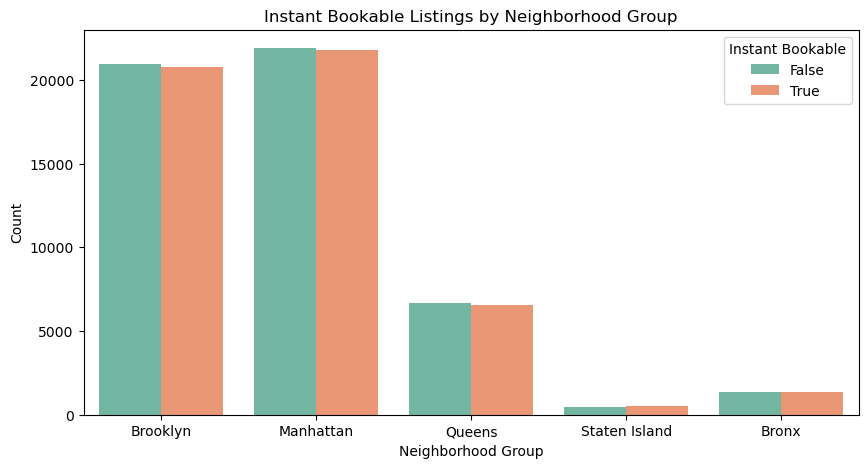

In [10]:
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='neighbourhood group', hue='instant_bookable', palette='Set2')
plt.title('Instant Bookable Listings by Neighborhood Group')
plt.xlabel('Neighborhood Group')
plt.ylabel('Count')
plt.legend(title='Instant Bookable')
plt.show()

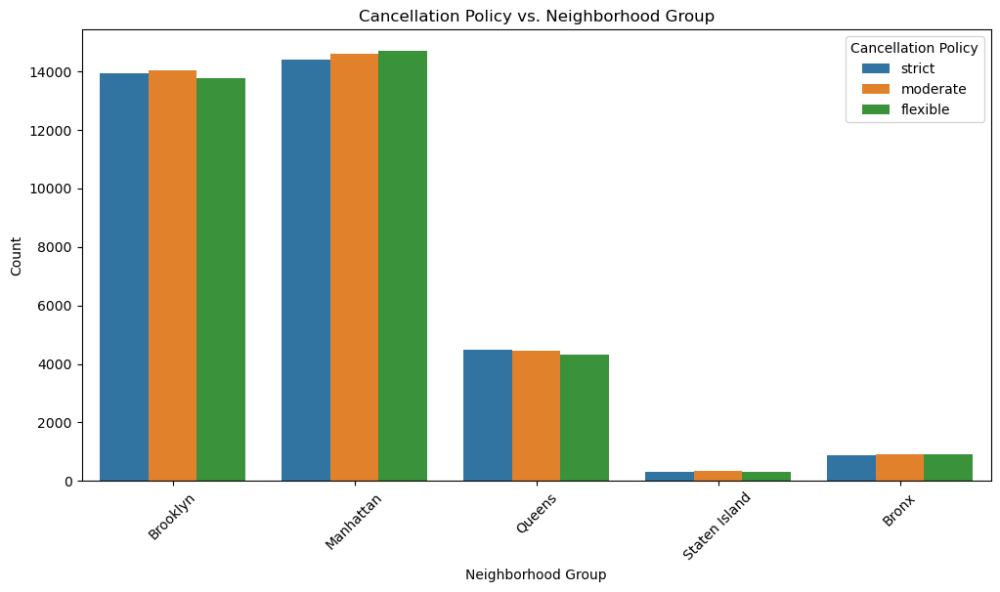

In [11]:
# Count plot to compare Cancellation Policy with Neighborhood Group
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='neighbourhood group', hue='cancellation_policy')
plt.title('Cancellation Policy vs. Neighborhood Group')
plt.xlabel('Neighborhood Group')
plt.ylabel('Count')
plt.legend(title='Cancellation Policy', loc='upper right')
plt.xticks(rotation=45)  
plt.show()


c:\Users\STEAVO\anaconda3\Lib\site-packages\seaborn\axisgrid.py:854: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


c:\Users\STEAVO\anaconda3\Lib\site-packages\seaborn\axisgrid.py:854: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


c:\Users\STEAVO\anaconda3\Lib\site-packages\seaborn\axisgrid.py:854: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




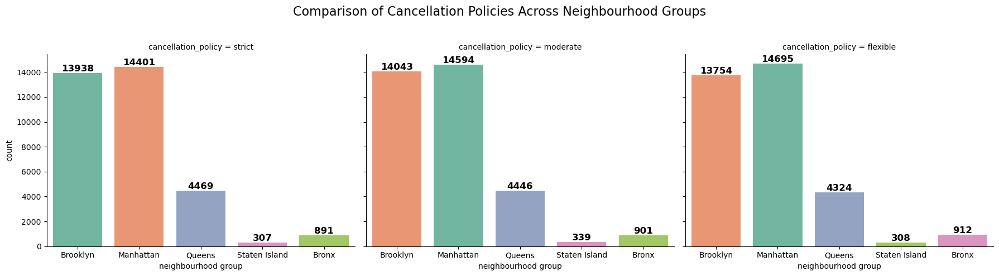

In [12]:
# Comparision between cancellation policies
filtered_df = df[df['cancellation_policy'].isin(['strict', 'moderate', 'flexible'])]

# Set figure size and create FacetGrid
g = sns.FacetGrid(filtered_df, col="cancellation_policy", sharey=True, height=5, aspect=1.2)

# Create count plot for each category
g.map_dataframe(sns.countplot, x="neighbourhood group", palette="Set2")

# Add count values on bars
for ax in g.axes.flat:
    for p in ax.patches:
        ax.annotate(f'{int(p.get_height())}',  
                    (p.get_x() + p.get_width() / 2, p.get_height()),
                    ha='center', va='bottom', fontsize=12, fontweight='bold', color='black')

# Add title
g.fig.suptitle("Comparison of Cancellation Policies Across Neighbourhood Groups", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit title

# Show the plot
plt.show()

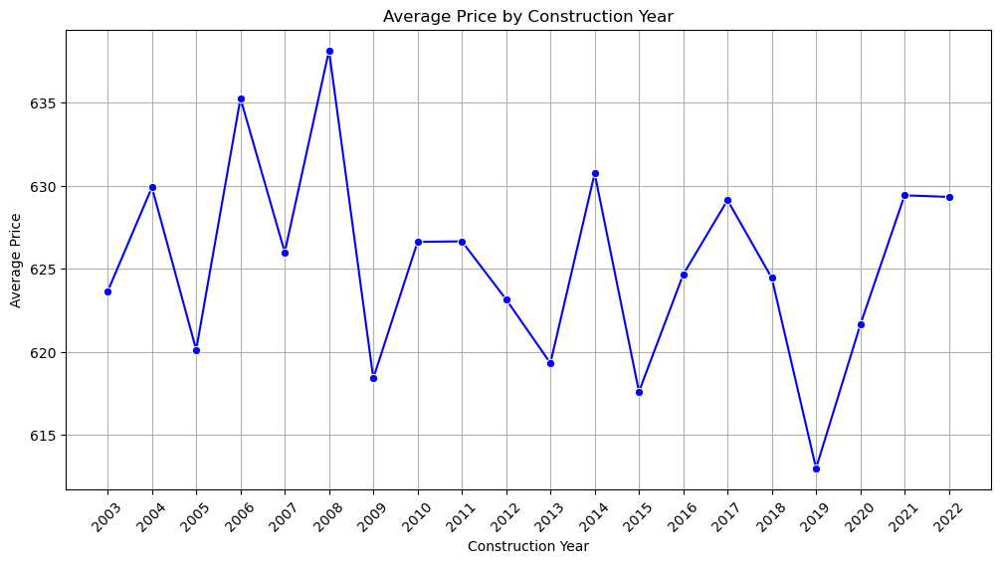

In [13]:
avg_price_per_year = df.groupby('Construction year', as_index=False)['price'].mean()
avg_price_per_year['Construction year'] = avg_price_per_year['Construction year'].astype(int) 
plt.figure(figsize=(12, 6))
sns.lineplot(data=avg_price_per_year, x='Construction year', y='price', color='blue', marker='o')

plt.xticks(avg_price_per_year['Construction year'], rotation=45)  
plt.title('Average Price by Construction Year')
plt.xlabel('Construction Year')
plt.ylabel('Average Price')
plt.grid(True)
plt.show()


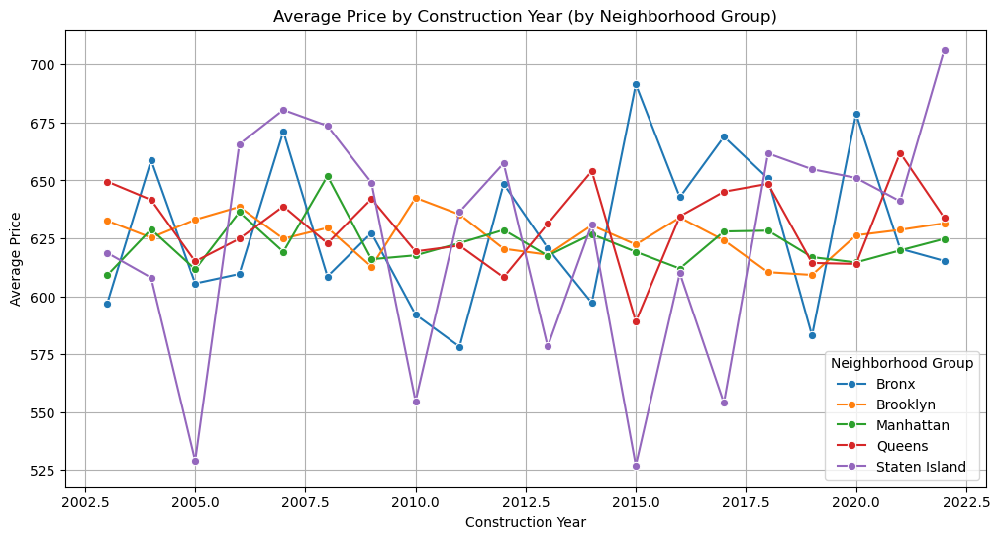

In [14]:
plt.figure(figsize=(12, 6))
df_grouped = df.groupby(['Construction year', 'neighbourhood group'])['price'].mean().reset_index()
sns.lineplot(data=df_grouped, x='Construction year', y='price', hue='neighbourhood group', marker='o')
plt.title('Average Price by Construction Year (by Neighborhood Group)')
plt.xlabel('Construction Year')
plt.ylabel('Average Price')
plt.legend(title='Neighborhood Group')
plt.grid(True)
plt.show()


c:\Users\STEAVO\anaconda3\Lib\site-packages\seaborn\axisgrid.py:854: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.


c:\Users\STEAVO\anaconda3\Lib\site-packages\seaborn\axisgrid.py:854: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




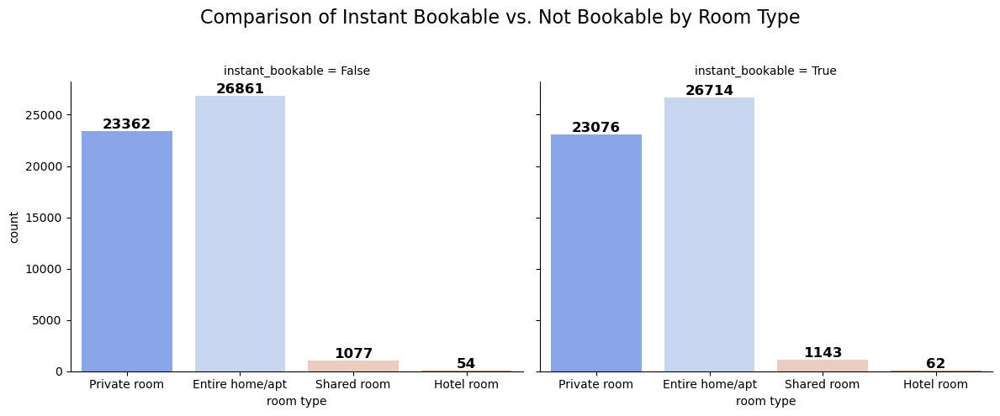

In [15]:
# Convert instant_bookable to boolean if it's stored as a string
if df['instant_bookable'].dtype == 'object':
    df['instant_bookable'] = df['instant_bookable'].map({'True': True, 'False': False})

# Filter data for only Instant Bookable (True/False)
filtered_df = df[df['instant_bookable'].isin([True, False])]

# Set figure size and create FacetGrid
g = sns.FacetGrid(filtered_df, col="instant_bookable", sharey=True, height=5, aspect=1.2)

# Create count plot for each category
g.map_dataframe(sns.countplot, x="room type", palette="coolwarm")  # Ensure correct column name

# Add count values on bars
for ax in g.axes.flat:
    for p in ax.patches:
        ax.annotate(f'{int(p.get_height())}',  
                    (p.get_x() + p.get_width() / 2, p.get_height()),
                    ha='center', va='bottom', fontsize=12, fontweight='bold', color='black')

# Add title
g.fig.suptitle("Comparison of Instant Bookable vs. Not Bookable by Room Type", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit title

# Show the plot
plt.show()


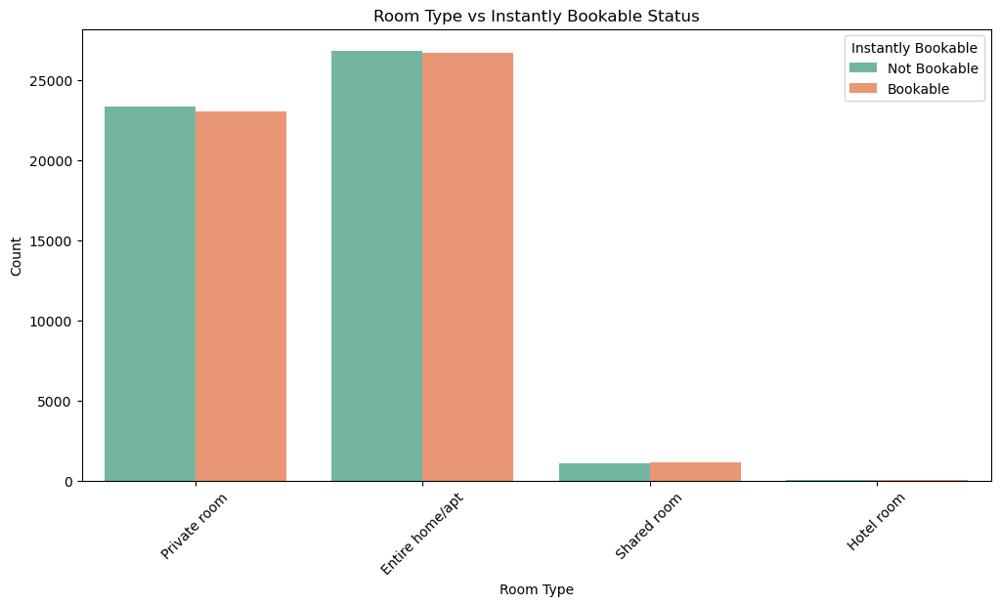

In [16]:
plt.figure(figsize=(12, 6))
sns.countplot(data=df, x='room type', hue='instant_bookable', palette='Set2')
plt.title('Room Type vs Instantly Bookable Status')
plt.xlabel('Room Type')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Instantly Bookable', labels=['Not Bookable', 'Bookable'])
plt.show()

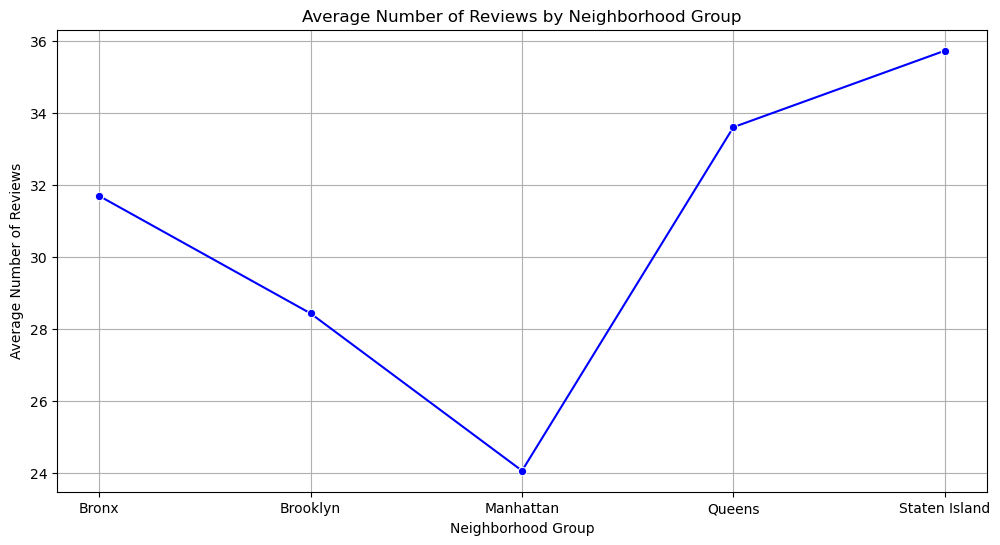

In [17]:
avg_reviews = df.groupby('neighbourhood group')['number of reviews'].mean().reset_index()

plt.figure(figsize=(12, 6))
sns.lineplot(data=avg_reviews, x='neighbourhood group', y='number of reviews', marker='o', color='blue')
plt.title('Average Number of Reviews by Neighborhood Group')
plt.xlabel('Neighborhood Group')
plt.ylabel('Average Number of Reviews')
plt.grid(True)
plt.show()

<Figure size 1200x600 with 0 Axes>

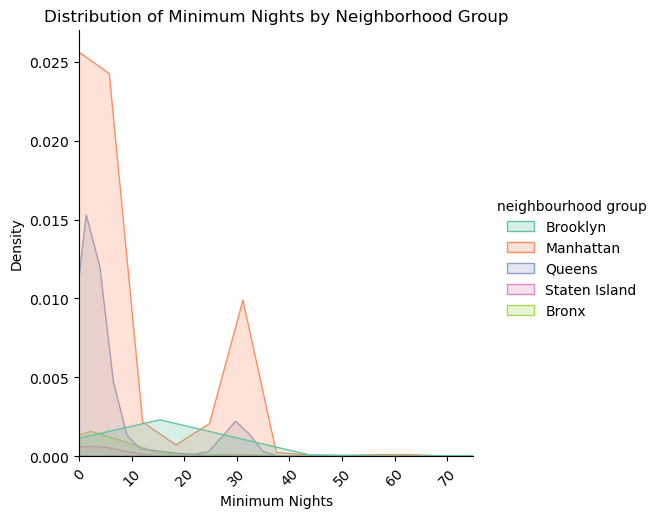

In [18]:
plt.figure(figsize=(12, 6))
sns.displot(data=df, x='minimum nights', hue='neighbourhood group', kind='kde', fill=True, palette='Set2')

plt.xlim(0, 75) 
plt.title('Distribution of Minimum Nights by Neighborhood Group')
plt.xlabel('Minimum Nights')
plt.ylabel('Density')
plt.xticks(rotation=45)
plt.show()

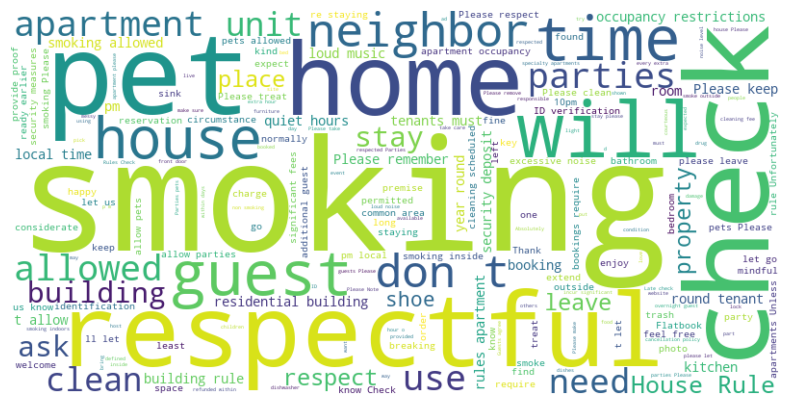

In [19]:
text = ' '.join(df['house_rules'].dropna())
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()